<a href="https://colab.research.google.com/github/dangdang2222/frankmocap_project/blob/main/2_camera_triangulation_visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [81]:
import pandas as pd
import numpy as np
import cv2

In [3]:
df0 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera0/local_keypoints/Motion2-1 - 1of4.csv').to_numpy()
df1 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera1/local_keypoints/Motion2-2 - 1of4.csv').to_numpy()
df2 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera2/local_keypoints/Motion2-3 - 1of4.csv').to_numpy()
df3 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera3/local_keypoints/Motion2-4 - 1of4.csv').to_numpy()
df4 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera4/local_keypoints/Motion2-5 - 1of4.csv').to_numpy()
df5 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera5/local_keypoints/Motion2-6 - 1of4.csv').to_numpy()
df6 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera6/local_keypoints/Motion2-7 - 1of4.csv').to_numpy()
df7 = pd.read_csv('/content/drive/MyDrive/2D Skeleton(CSV), JPG/camera7/local_keypoints/Motion2-8 - 1of4.csv').to_numpy()

[Nose][LEye][REye][Lear][Rear][LShoulder][RShoulder][LElbow][RElbow][LWrist][RWrist][LHip][RHip][LKnee][RKnee][LAnkle][RAnkle][Head][Neck][Hip][LBigToe][RBigToe][LSmallToe][RSmallToe][LHeel][RHeel]

(301,8,26,2)로 만들기
(frame, camera, point, dimension)

In [4]:
a=[]
for frame_idx in range(301):
  point_array0=[]
  point_array1=[]
  point_array2=[]
  point_array3=[]
  point_array4=[]
  point_array5=[]
  point_array6=[]
  point_array7=[]
  for point_idx in range(1,27):
    point_array0.append([df0[frame_idx][2*point_idx-1],df0[frame_idx][2*point_idx]])
    point_array1.append([df1[frame_idx][2*point_idx-1],df1[frame_idx][2*point_idx]])
    point_array2.append([df2[frame_idx][2*point_idx-1],df2[frame_idx][2*point_idx]])
    point_array3.append([df3[frame_idx][2*point_idx-1],df3[frame_idx][2*point_idx]])
    point_array4.append([df4[frame_idx][2*point_idx-1],df4[frame_idx][2*point_idx]])
    point_array5.append([df5[frame_idx][2*point_idx-1],df5[frame_idx][2*point_idx]])
    point_array6.append([df6[frame_idx][2*point_idx-1],df6[frame_idx][2*point_idx]])
    point_array7.append([df7[frame_idx][2*point_idx-1],df7[frame_idx][2*point_idx]])
  a.append([point_array0,point_array1,point_array2,point_array3,point_array4,point_array5,point_array6,point_array7])

# 1,2번 카메라에 대해서

## camera P 계산

In [51]:
K = np.array([[1050.74627,0,959.5],[0,1052.54163,539.5],[0,0,1]])
Rt1 = np.array([[-0.060679, 0.998130, 0.007343,-605.413346],[0.418569, 0.032123, -0.907617, 548.137858],[-0.906156,-0.052000,-0.419735,4336.592638]])
P1 = np.dot(K,Rt1)
P1 = np.concatenate((P1,np.array([[0,0,0,1]])),axis=0)
Rt2 = np.array([[ -0.066097,-0.997812,0.001260,653.352810],[-0.432199,0.027492,-0.901359,1175.918886],[0.899353 ,-0.060121,-0.433071,3114.943323]])
P2 = np.dot(K,Rt2)
P2 = np.concatenate((P2,np.array([[0,0,0,1]])),axis=0)

print(P1, P2)
print(P1.shape, P2.shape)

[[-9.33214915e+02  9.98887374e+02 -3.95020103e+02  3.52482482e+06]
 [-4.83098645e+01  5.75679478e+00 -1.18175171e+03  2.91652964e+06]
 [-9.06156000e-01 -5.20000000e-02 -4.19735000e-01  4.33659264e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]] [[ 7.93478027e+02 -1.10613334e+03 -4.14207684e+02  3.67529615e+06]
 [ 3.02935036e+01 -3.49880501e+00 -1.18235968e+03  2.91821550e+06]
 [ 8.99353000e-01 -6.01210000e-02 -4.33071000e-01  3.11494332e+03]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  1.00000000e+00]]
(4, 4) (4, 4)


## 2 camera 1 point 1 frame

In [ ]:
arr = np.array(a)

a3 = arr[0][0][0] #frame, cam_num, point_num
a3.resize(2,1)
b3 = arr[0][1][0]
b3.resize(2,1)

X = cv2.triangulatePoints(P1[:3],P2[:3],a3,b3)
X/=X[3]
X

In [ ]:
x1 = np.dot(P1[:3],X)
x1 /= x1[2]
x1

x2 = np.dot(P2[:3],X)
x2 /= x2[2]
x2

## 2 camera 26 point 1 frame

In [148]:
camera_positions = np.array([[0,0,0],[150,-150,500],[150,150,500],[-150,150,500],[-150,-150,500]],dtype= np.float32)
world_positions = np.array([[0,0,0],[150,-150,150],[150,150,150],[-150,150,500],[-150,-150,150]],dtype=np.float32)
mat_rots = np.array([[[ -0.060679,0.998130,0.007343],[0.418569,0.032123,-0.907617],[-0.906156,-0.052000,-0.419735]],
                    [[-0.066097,-0.997812,0.001260],[-0.432199,0.027492,-0.901359],[0.899353,-0.060121,-0.433071]],
                    [[ 0.784980,-0.619352,-0.014461],[-0.276741,-0.329672,-0.902624],[0.554275,0.712544,-0.430186 ]],
                    [[-0.999920,-0.012570,-0.001528],[-0.003610,0.398618,-0.917110],[0.012137,-0.917031,-0.398631]],
                    [[-0.733829,-0.677994,-0.042651],[-0.217095,0.293539,-0.930970],[0.643711,-0.673913,-0.362597]],
                    [[0.799458,0.600171,-0.025722],[0.247259,-0.367782,-0.896437],[-0.547476,0.710304,-0.442424 ]],
                    [[ -0.755252,0.655282, 0.014137],[0.279717,0.341747,-0.897200],[-0.592750,-0.673657,-0.441399]],
                    [[0.999871,0.015922,0.002158],[0.008548,-0.413380,-0.910518],[-0.013605,0.910419,-0.413463 ]]])
mat_transs = np.array([[[-605.413346],[548.137858],[4336.592638]],
                      [[653.352810],[1175.918886],[3114.943323]],
                      [[-420.172604],[295.490400],[4881.382220]],
                      [[ 728.642753],[7.551169],[5699.942529]],
                      [[ 1966.137295],[76.021013],[5872.706559]],
                      [[-704.819635],[-127.891999],[5625.110129]],
                      [[ -737.902102],[-790.877554],[6746.539080]],
                      [[-621.529759],[660.889110 ],[4254.063740 ]]])

In [149]:
D = []

for point in range(0,26):
  a = arr[0][0][point]
  a.resize(2,1)

  b = arr[0][1][point]
  b.resize(2,1)

  X = cv2.triangulatePoints(P1[:3],P2[:3],a,b)
  X /= X[3]

  D.append(X)

In [139]:
import numpy as np
import matplotlib as mpl
import matplotlib.pyplot as plt
from matplotlib.patches import Patch
from mpl_toolkits.mplot3d.art3d import Poly3DCollection

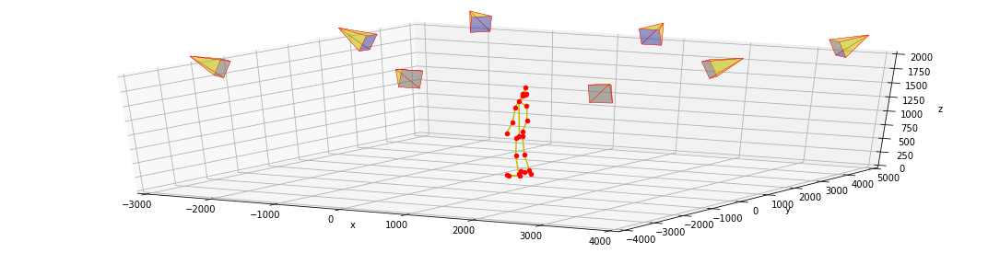

In [153]:
world_position=[]

fig = plt.figure(figsize=(6.4*3, 4.8))
ax = fig.add_subplot(projection='3d')
ax.set_aspect("auto")
ax.set_xlim([-3000, 4000])
ax.set_ylim([-4000, 5000])
ax.set_zlim([0, 2000])
ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')
for mat_rot,mat_trans in zip(mat_rots,mat_transs):
  for indx, i in enumerate(camera_positions):
    cam_position = np.array([[i[0]],[i[1]],[i[2]]])
    world_point = np.matrix(mat_rot.T)*(np.matrix(cam_position - mat_trans))

    world_positions[indx] = world_point.reshape(-1)
  f_world_positions = np.concatenate([world_positions.T, np.array([[1,1,1,1,1]])],axis=0).T
  vertex_transformed = np.concatenate([world_positions.T, np.array([[1,1,1,1,1]])],axis=0).T
  meshes = [[vertex_transformed[0, :-1], vertex_transformed[1][:-1], vertex_transformed[2, :-1]],
                              [vertex_transformed[0, :-1], vertex_transformed[2, :-1], vertex_transformed[3, :-1]],
                              [vertex_transformed[0, :-1], vertex_transformed[3, :-1], vertex_transformed[4, :-1]],
                              [vertex_transformed[0, :-1], vertex_transformed[4, :-1], vertex_transformed[1, :-1]],
                              [vertex_transformed[1, :-1], vertex_transformed[2, :-1], vertex_transformed[3, :-1], vertex_transformed[4, :-1]]]
                           
  ax.add_collection3d(Poly3DCollection(meshes ,facecolors=['y','y','y','y','b'], linewidths=0.3, edgecolors='r', alpha=0.35))
for i in D:
  i.reshape(-1)
  ax.scatter(xs = i[0], ys = i[1], zs = i[2],color='r')

R_array = np.array([[3, 17],[4 , 17],[3,18],[4,18],[5,18],[6,18],[5,7],[6,8],[7,9],[8,10],[11,19],[12,19],[11,13],[12,14],[13,15],[14,16],[15,24],[16,25],[20,24],[21,25],[22,24],[23,25],[19,18]])

for r_list in R_array:
  a = r_list[0]
  b = r_list[1]
  ax.plot(xs = [D[a].reshape(-1)[0],D[b].reshape(-1)[0]],ys = [D[a].reshape(-1)[1],D[b].reshape(-1)[1]],zs = [D[a].reshape(-1)[2],D[b].reshape(-1)[2]],c='y')
plt.show()

In [ ]:
fig = plt.figure(figsize=(6.4*2, 4.8*2))
ax = fig.add_subplot(projection='3d')
ax.set_aspect("auto")
ax.set_xlim([-3000, 4000])
ax.set_ylim([-4000, 5000])
ax.set_zlim([0, 2000])

ax.set_xlabel('x')
ax.set_ylabel('y')
ax.set_zlabel('z')

for i in D:
  i.reshape(-1)
  ax.scatter(xs = i[0], ys = i[1], zs = i[2],color='r')

R_array = np.array([[3, 17],[4 , 17],[3,18],[4,18],[5,18],[6,18],[5,7],[6,8],[7,9],[8,10],[11,19],[12,19],[11,13],[12,14],[13,15],[14,16],[15,24],[16,25],[20,24],[21,25],[22,24],[23,25],[19,18]])

for r_list in R_array:
  a = r_list[0]
  b = r_list[1]
  ax.plot(xs = [D[a].reshape(-1)[0],D[b].reshape(-1)[0]],ys = [D[a].reshape(-1)[1],D[b].reshape(-1)[1]],zs = [D[a].reshape(-1)[2],D[b].reshape(-1)[2]],c='y')
plt.show()

## 2 camera 26 point 301 frame

In [156]:
D = []
for frame in range(301):
  d = []
  for point in range(0,26):
    a = arr[frame][0][point]
    a.resize(2,1)

    b = arr[frame][1][point]
    b.resize(2,1)

    X = cv2.triangulatePoints(P1[:3], P2[:3], a,b)
    X /= X[3]

    d.append(X)
  D.append(d)

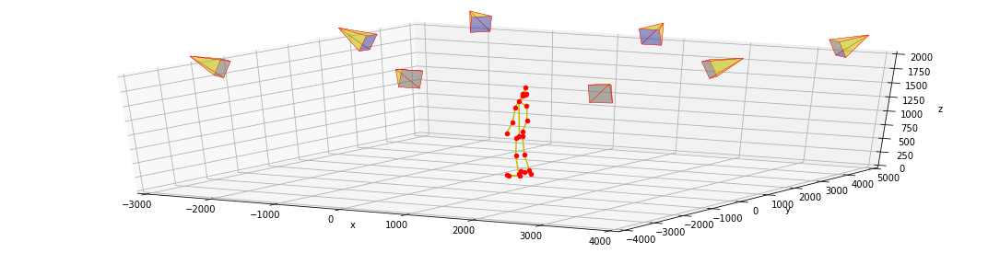

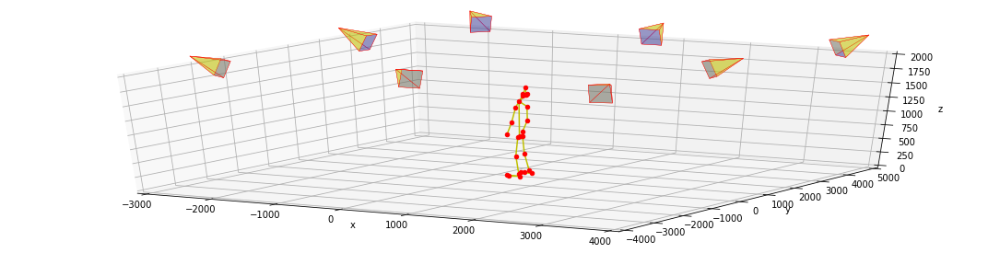

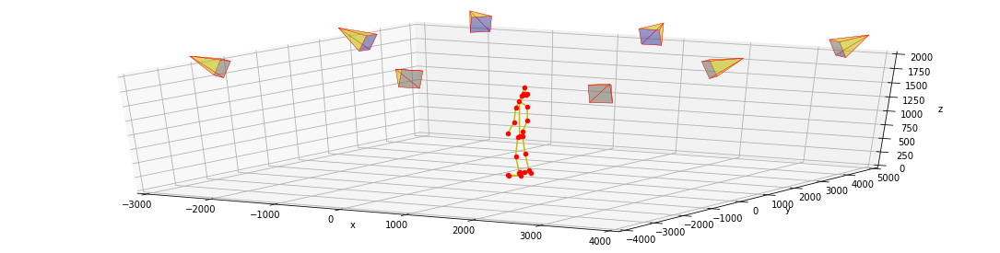

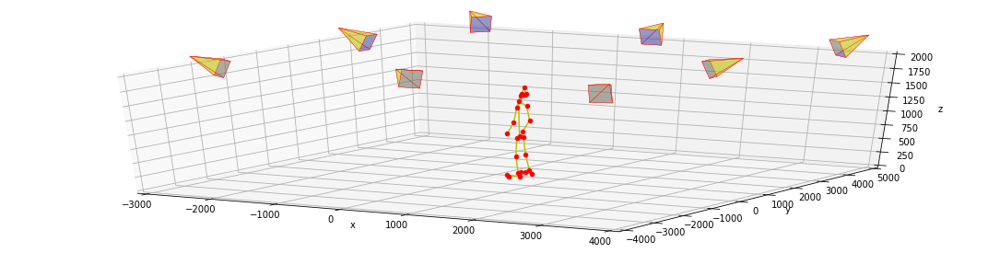

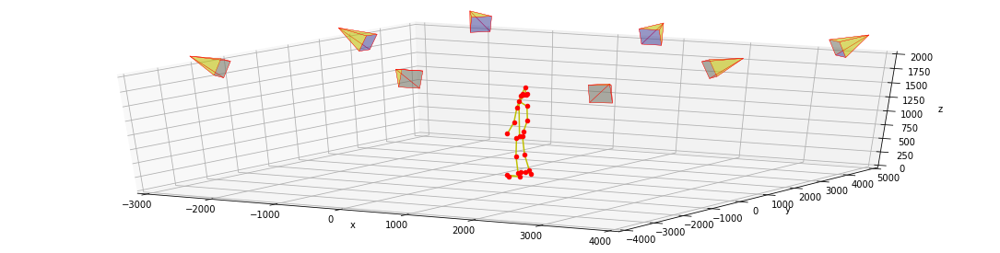

...

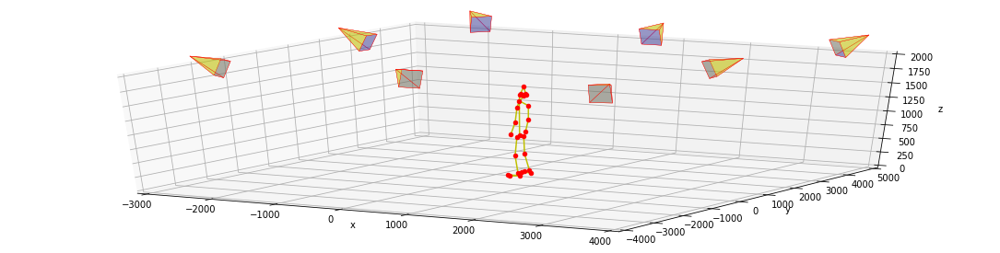

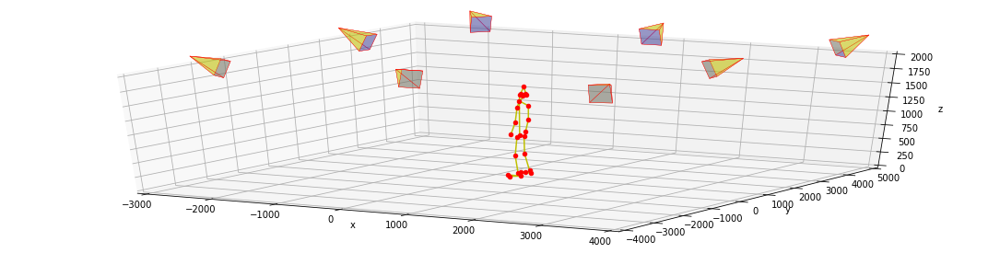

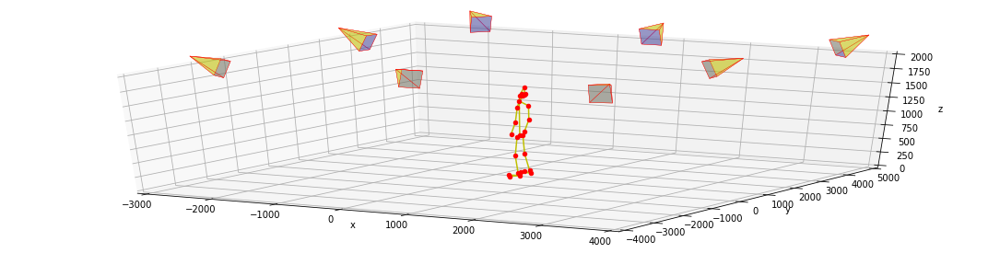

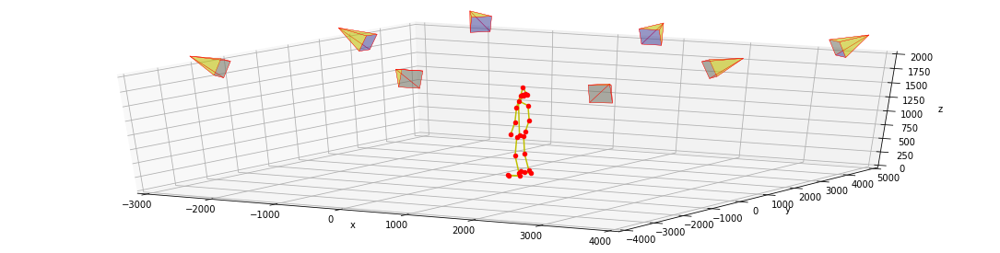

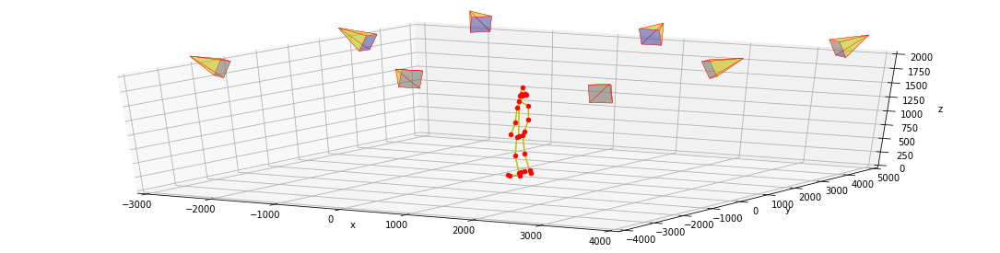

In [157]:
for frame in range(301):
  d = D[frame]
  world_position=[]

  fig = plt.figure(figsize=(6.4*3, 4.8))
  ax = fig.add_subplot(projection='3d')
  ax.set_aspect("auto")
  ax.set_xlim([-3000, 4000])
  ax.set_ylim([-4000, 5000])
  ax.set_zlim([0, 2000])
  ax.set_xlabel('x')
  ax.set_ylabel('y')
  ax.set_zlabel('z')
  for mat_rot,mat_trans in zip(mat_rots,mat_transs):
    for indx, i in enumerate(camera_positions):
      cam_position = np.array([[i[0]],[i[1]],[i[2]]])
      world_point = np.matrix(mat_rot.T)*(np.matrix(cam_position - mat_trans))

      world_positions[indx] = world_point.reshape(-1)
    f_world_positions = np.concatenate([world_positions.T, np.array([[1,1,1,1,1]])],axis=0).T
    vertex_transformed = np.concatenate([world_positions.T, np.array([[1,1,1,1,1]])],axis=0).T
    meshes = [[vertex_transformed[0, :-1], vertex_transformed[1][:-1], vertex_transformed[2, :-1]],
                                [vertex_transformed[0, :-1], vertex_transformed[2, :-1], vertex_transformed[3, :-1]],
                                [vertex_transformed[0, :-1], vertex_transformed[3, :-1], vertex_transformed[4, :-1]],
                                [vertex_transformed[0, :-1], vertex_transformed[4, :-1], vertex_transformed[1, :-1]],
                                [vertex_transformed[1, :-1], vertex_transformed[2, :-1], vertex_transformed[3, :-1], vertex_transformed[4, :-1]]]
                            
    ax.add_collection3d(Poly3DCollection(meshes ,facecolors=['y','y','y','y','b'], linewidths=0.3, edgecolors='r', alpha=0.35))
  for i in d:
    i.reshape(-1)
    ax.scatter(xs=i[0],ys=i[1],zs=i[2],color='r')
  R_array = np.array([[3, 17],[4 , 17],[3,18],[4,18],[5,18],[6,18],[5,7],[6,8],[7,9],[8,10],[11,19],[12,19],[11,13],[12,14],[13,15],[14,16],[15,24],[16,25],[20,24],[21,25],[22,24],[23,25],[19,18]])

  for r_list in R_array:
    a = r_list[0]
    b = r_list[1]
    ax.plot(xs = [d[a].reshape(-1)[0],d[b].reshape(-1)[0]],ys = [d[a].reshape(-1)[1],d[b].reshape(-1)[1]],zs = [d[a].reshape(-1)[2],d[b].reshape(-1)[2]],c='y')
  plt.show()

  if frame<10:
    name = '/content/drive/MyDrive/2D Skeleton(CSV), JPG/save2/s0000'+str(frame)+'.jpg'
  elif frame<100:
    name = '/content/drive/MyDrive/2D Skeleton(CSV), JPG/save2/s000'+str(frame)+'.jpg'
  else:
    name = '/content/drive/MyDrive/2D Skeleton(CSV), JPG/save2/s00'+str(frame)+'.jpg'
  fig.savefig(name)


## video

In [ ]:
img_array = []

for filename in glob.glob('*.jpg'):
    img = cv2.imread(filename)
    height, width, layers = img.shape
    size = (width, height)
    img_array.append(img)
out = cv2.VideoWriter('save.avi',cv2.VideoWriter_fourcc(*'DIVX'),15,size)
for i in range(len(img_array)):
    out.write(img_array[i])
out.release()